<a href="https://colab.research.google.com/github/gabrielyuto/Exercises-object-oriented-programming/blob/master/Olist2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Instalação de pacotes

Vamos instalar os pacotes:

- `geopy`  (cálculo de distâncias entre coordenadas)
- `umap-learn` (redução da dimensionalidade usando o método umap)
- `kneed` para plotar o gráfico do cotovelo e achar o ponto


In [ ]:
!pip install geopy

In [ ]:
!pip install umap-learn

In [ ]:
!pip install kneed

# Dados

Para agilizar o processo, eu coloquei a base de dados no endereço a seguir, assim podemos baixar diretamente, e evitamos a demora em fazer o upload. O `wget` é usado para baixar o arquivo, e o `unzip` para descompactar.

In [ ]:
!wget http://professor.ufabc.edu.br/~ronaldo.prati/archive.zip

--2023-07-07 23:43:21--  http://professor.ufabc.edu.br/~ronaldo.prati/archive.zip
Resolving professor.ufabc.edu.br (professor.ufabc.edu.br)... 177.104.50.68, 2801:a4:fabc:1034::68
Connecting to professor.ufabc.edu.br (professor.ufabc.edu.br)|177.104.50.68|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 44717580 (43M) [application/zip]
Saving to: ‘archive.zip.1’

archive.zip.1       100%[===================>]  42.65M  16.7MB/s    in 2.5s    

2023-07-07 23:43:24 (16.7 MB/s) - ‘archive.zip.1’ saved [44717580/44717580]



In [ ]:
#!unzip archive.zip

Archive:  archive.zip
replace olist_customers_dataset.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: N


Vamos agora refazer os passos da última aula, carregando os dados e unificando em um única tabela. Também convertemos os dados no formato data, calculamos a distância entre a origem e destino, e os tempos de entrega.

In [ ]:
import pandas as pd
import geopy.distance as gp

*Carregar* as bases de dados

In [ ]:
df_item = pd.read_csv("olist_order_items_dataset.csv")
df_reviews = pd.read_csv("olist_order_reviews_dataset.csv")
df_orders = pd.read_csv("olist_orders_dataset.csv")
df_products = pd.read_csv("olist_products_dataset.csv")
df_geolocation = pd.read_csv("olist_geolocation_dataset.csv")
df_sellers = pd.read_csv("olist_sellers_dataset.csv")
df_order_pay = pd.read_csv("olist_order_payments_dataset.csv")
df_customers = pd.read_csv("olist_customers_dataset.csv")
df_category = pd.read_csv("product_category_name_translation.csv")

Unir todos em uma única tabela

In [ ]:
df = pd.merge(df_orders, df_item, on='order_id')
df = pd.merge(df,df_products, on='product_id')
df = pd.merge(df,df_sellers, on='seller_id')
df = pd.merge(df,df_customers, on='customer_id')
df = pd.merge(df,df_order_pay, on='order_id',how='right')
df = pd.merge(df,df_reviews, on='order_id')

Nomes das colunas que envolvem data e hora

In [ ]:
date_columns = ['order_purchase_timestamp','order_approved_at', 'order_delivered_carrier_date',
                'order_delivered_customer_date', 'order_estimated_delivery_date', 'shipping_limit_date',
                'review_creation_date', 'review_answer_timestamp']

Faz a conversão dessas colunas para o format datetime

In [ ]:
df = df.assign(**df[date_columns].apply(pd.to_datetime))

Calcula o tempo de entrega, o tempo estimado, o tempo máximo de despacho, e o tempo de revisão da compra.

In [ ]:
df['deliver_time'] = df['order_delivered_customer_date'] - df['order_purchase_timestamp']
df['deliver_estimate'] = df['order_estimated_delivery_date'] - df['order_purchase_timestamp']
df['max_shipping_time'] = df['shipping_limit_date'] - df['order_purchase_timestamp']
df['review_time'] = df['review_creation_date'] - df['order_delivered_customer_date']

Calcula a distância entre a origem e o destino


In [ ]:
df_geolocation = df_geolocation.drop_duplicates()

In [ ]:
df_geo = df_geolocation.groupby('geolocation_zip_code_prefix').mean()

<ipython-input-13-d3617efe8ef2>:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df_geo = df_geolocation.groupby('geolocation_zip_code_prefix').mean()


In [ ]:
def geo_dist_zip(seller_zip_code_prefix, customer_zip_code_prefix):
    try:
        coord_seller = list(df_geo.loc[seller_zip_code_prefix])
        coord_customer = list(df_geo.loc[customer_zip_code_prefix])
        return gp.geodesic(coord_seller,coord_customer).km
    except:
        return

In [ ]:
df['distance'] = df.apply(lambda x: geo_dist_zip(x['seller_zip_code_prefix'],x['customer_zip_code_prefix']),axis=1)

Vamos fazer olhar os atributos numéricos da base de dados. A lista a seguir contém esses atributos.

In [ ]:
columns = ['price', 'freight_value', 'product_name_lenght', 'product_description_lenght',
       'product_photos_qty', 'product_weight_g', 'product_length_cm',
       'product_height_cm', 'product_width_cm', 'payment_installments', 'payment_value', 'distance', 'deliver_time',
       'deliver_estimate', 'max_shipping_time', 'review_time']

Finalmente, vamos converter os atributos de tempo de entraga para um valor numérico

In [ ]:
df = df.assign(**df[['deliver_time','deliver_estimate',
                     'max_shipping_time', 'review_time']].apply(lambda x: x.dt.total_seconds()/(24*60*60)))

## Visualização e agrupamento

Vamos começar carrenado as bibliotecas

- `umap` gera a visualização usando o método UMAP
- `numpy` é útil para cálculos em matrizes
- `plotly` é usada para gráficos interativos
- `sklearn` tem vários algoritmos de aprendizado de máquina
- `yellowbrick`tem funções para avaliar agrupamento.

In [ ]:
import umap
import numpy as np

import plotly.express as px
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer

Vamos começar com PCA. Para que possamos visualizar, vamos limitar o número de componentes em três. Além disso, precisamos normalizar os dados. Ambos os métodos estão implementados na biblioteca `sklearn`, e para usá-los, vamos precisar instanciar os objetos:

In [ ]:
standardizer = StandardScaler()
pca = PCA(n_components=3)


O PCA não fuciona caso haja valores nulos na base. Um fator comum de valor nulo nesta base é de pedido ainda não entregue, entre outros. Poderíamos tentrar de alguma maneira preencher os valores nulos, mas no nosso caso, como uma das principais causas é o pedido ainda não entregue, podemos removê-los. Na célula a seguir, selecionamos apenas os atributos numéricos e filtramos os valores nulos, apagando a linha inteira caso  qualquer valor seja nulo (`NA`).

In [ ]:
X = df[columns].dropna(axis = 0, how = 'any')

Agora podemos normalizar os dados. No `sklearn`, geralmente usamos os métoso `fit`, `transform`, e `fit_transform` para os métodos de pre-processamento. O método `fit` ajusta o modelo para o conjunto de dados específico, o `transform` aplica o método para um conjunto de dados, e o `fit_transform` faz os dois passos de uma vez só. A linha a seguir cria uma versão normalizada dos dados:

In [ ]:
X_normal = standardizer.fit_transform(X)

Uma vez normalizados, podemos aplicar PCA. Novamente usamos o `fit_transform`, que já devolve o conjunto de dados projetado em três dimensões:

In [ ]:
pca_proj = pca.fit_transform(X_normal)

Podemos verificar o quanto da variância conseguimos capturar convertendo os dados para três dimensões:

In [ ]:
pca.explained_variance_ratio_.sum()

0.436041446980672

Agora, podemos visualizar essas três dimensões em um gráfico. Para poder interagir com o gráfico, ele foi gerado com a biblioteca `plotly`, e mapeamos cada uma das dimensões em um eixo. Além disso, para poder explorar a visualização dos dados, podemos mapear uma outra característica como cor. Na célula a seguir, mapeamos o preço, distância e tempo de entrega:

In [ ]:
fig = px.scatter_3d(x=pca_proj[:,0],y=pca_proj[:,1], z=pca_proj[:,2], color = np.log10(X['price']))
#fig = px.scatter_3d(x=pca_proj[:,0],y=pca_proj[:,1], z=pca_proj[:,2], color = np.sqrt(X['distance']))
#fig = px.scatter_3d(x=pca_proj[:,0],y=pca_proj[:,1], z=pca_proj[:,2], color = X['deliver_time'])
fig.show()

Uma outra técnica de redução de dimensionalidade (não linear, neste caso) é a UMAP. O `sklearn` também tem a t-SNE, mas ela é muito demorada para a nossa base de dados. O UMAP está disponível na biblioteca `umap`, e como fizemos com a PCA, vamos reduzir para três dimensões:

In [ ]:
umap_reducer = umap.UMAP(n_components=3)

A biblioteca `umap` usa a mesma interface da `sklearn`, e podemos usar o `fit_transform` para criar a projeção:

In [ ]:
umap_proj = umap_reducer.fit_transform(X_normal)

E podemos também visualizar essa projeção:

In [ ]:
#fig = px.scatter_3d(x=umap_proj[:,0],y=umap_proj[:,1], z=umap_proj[:,2], color = np.log10(X['price']))
#fig = px.scatter_3d(x=umap_proj[:,0],y=umap_proj[:,1], z=umap_proj[:,2], color = np.sqrt(X['distance']))
fig = px.scatter_3d(x=umap_proj[:,0],y=umap_proj[:,1], z=umap_proj[:,2], color = X['deliver_time'])
fig.show()

# Criação de grupos

Agora vamos usar o k-means para gerar grupos a partir dos dados. Inicialmente, vamos testar vários valores para o número de cluster, e fazer o gráfico do cotovelo. Para isso, vamos usar o método `KElbowVisualizer` para gerar o gráfico do cotovelo.

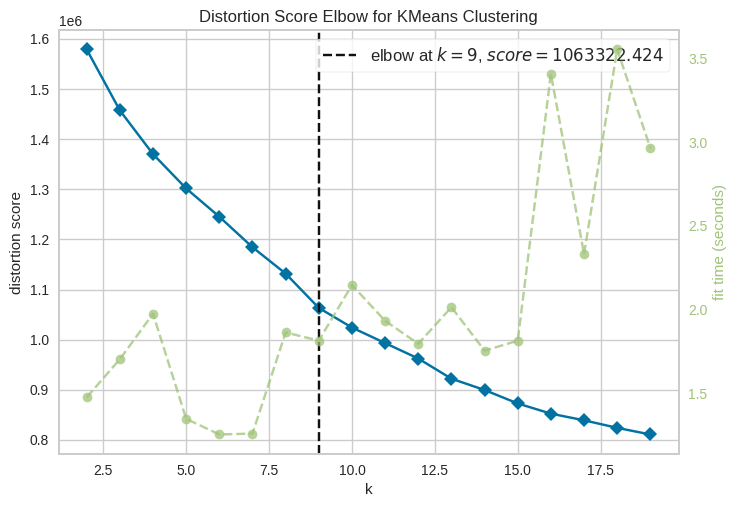

Número de grupos sugerigos: 9


In [ ]:
model = KMeans(n_init=5)
elbowvisualizer = KElbowVisualizer(model, k=(2,20))

elbowvisualizer.fit(X_normal)    # Fit the data to the visualizer
elbowvisualizer.poof()
print('Número de grupos sugerigos:', elbowvisualizer.elbow_value_)

Uma vez que escolhemos o número de clusters, podemos criar o modelo final:

In [ ]:
final_model = KMeans(n_clusters=elbowvisualizer.elbow_value_,n_init='auto')
final_model.fit_transform(X_normal)
fig = px.scatter_3d(x=pca_proj[:,0],y=pca_proj[:,1], z=pca_proj[:,2], color = final_model.labels_)
fig.show()

E plotar o gráfico da silhueta:

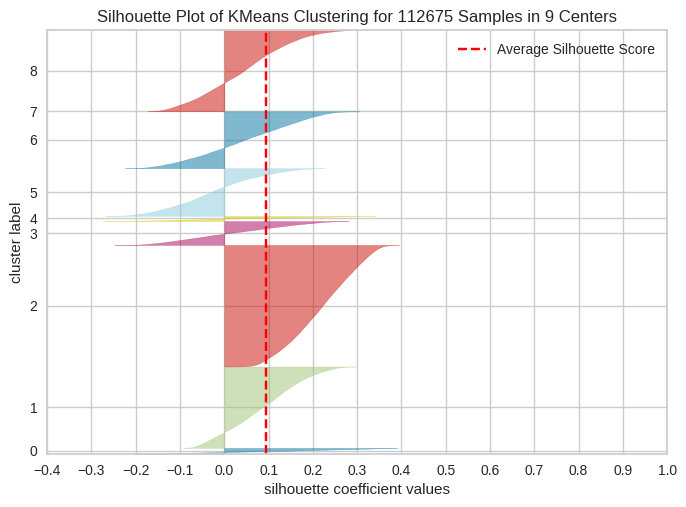

<Axes: title={'center': 'Silhouette Plot of KMeans Clustering for 112675 Samples in 9 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [ ]:
visualizer = SilhouetteVisualizer(final_model, colors='yellowbrick')

visualizer.fit(X_normal)        # Fit the data to the visualizer
visualizer.show()

In [ ]:
X['kmeans_group'] = final_model.labels_

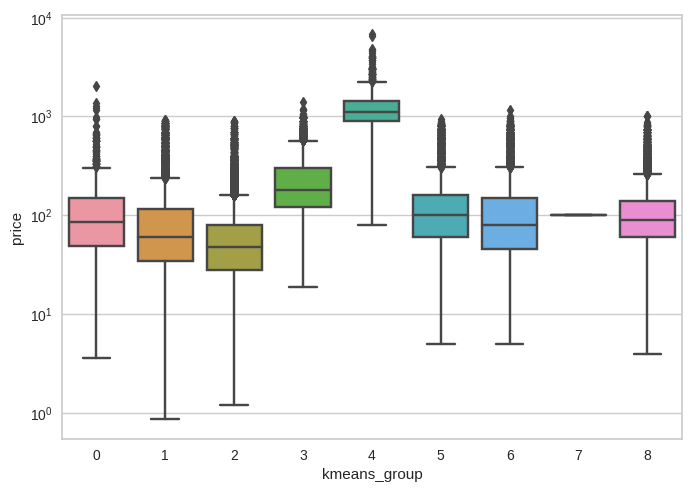

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.boxplot(data=X, x='kmeans_group', y='price')
plt.yscale('log')

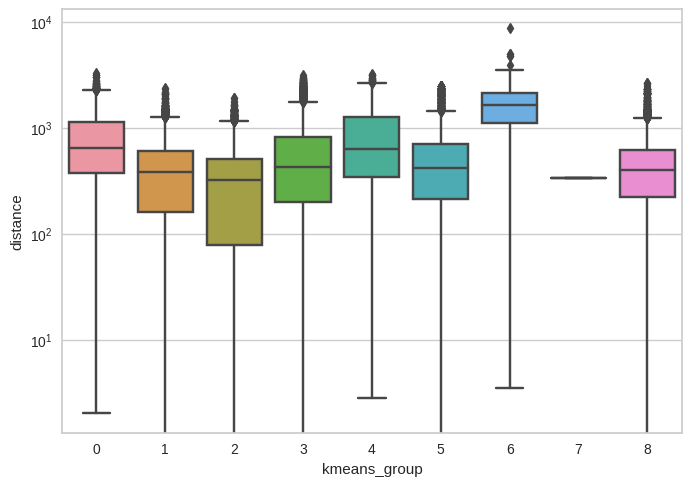

In [ ]:
sns.boxplot(data=X, x='kmeans_group', y='distance')
plt.yscale('log')

<Axes: xlabel='kmeans_group', ylabel='deliver_time'>

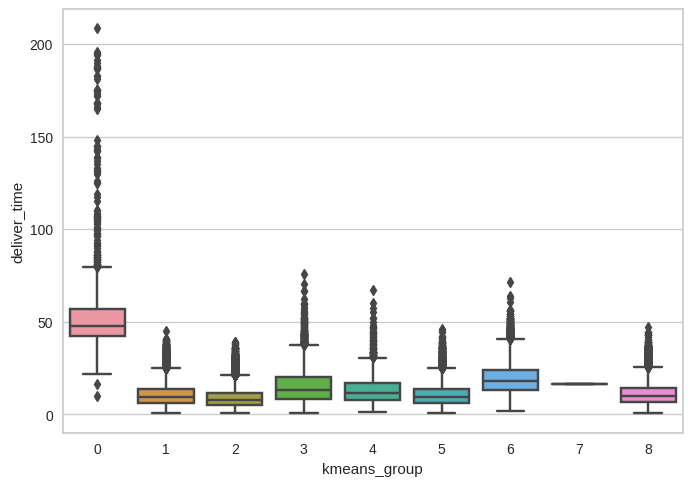

In [ ]:
  sns.boxplot(data=X, x='kmeans_group', y='deliver_time')